In [247]:
#Import libaries

import pandas as pd
import seaborn as sns
import numpy as np

import matplotlib
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8) #Adjusts the configuration of the plots we will create

#Read in the data
df = pd.read_csv(r"C:\Users\jerom\DS_studying\Data Analyst Portfolio Project\Project4_Correlation in Python\movies.csv")


In [249]:
#Data

df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [250]:
#Let's see if there is any missing data

for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col,pct_missing))


name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [251]:
#Drop rows with missing values
df = df.dropna()
df.isnull().sum()


name        0
rating      0
genre       0
year        0
released    0
score       0
votes       0
director    0
writer      0
star        0
country     0
budget      0
gross       0
company     0
runtime     0
dtype: int64

In [252]:
# Data types for our columns

df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [253]:
# change data type of colums for delete first decimal place(0)

df['budget'] = df['budget'].astype('int64')
df['gross'] = df['gross'].astype('int64')
df['runtime'] = df['runtime'].astype(int)
df['votes'] = df['votes'].astype(int)


In [254]:
#Clean and standardize the released column

df['released'] = df['released'].str.split('(').str[0].str.strip()
df['released'] = pd.to_datetime(df['released'], errors='coerce')

df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,1980-06-13,8.4,927000,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146
1,The Blue Lagoon,R,Adventure,1980,1980-07-02,5.8,65000,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,1980-06-20,8.7,1200000,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124
3,Airplane!,PG,Comedy,1980,1980-07-02,7.7,221000,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88
4,Caddyshack,R,Comedy,1980,1980-07-25,7.3,108000,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98
5,Friday the 13th,R,Horror,1980,1980-05-09,6.4,123000,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95
6,The Blues Brothers,R,Action,1980,1980-06-20,7.9,188000,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133
7,Raging Bull,R,Biography,1980,1980-12-19,8.2,330000,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129
8,Superman II,PG,Action,1980,1981-06-19,6.8,101000,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127
9,The Long Riders,R,Biography,1980,1980-05-16,7.0,10000,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100


In [255]:
df = df.dropna(subset=['released'])

In [256]:
#Create correct Year Column

df['Year_correct'] = df['released'].astype(str).str[:4]

C:\Users\jerom\AppData\Local\Temp\ipykernel_43336\742358914.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year_correct'] = df['released'].astype(str).str[:4]


In [257]:
df['Year_correct'] = df['Year_correct'].astype(int)

df.loc[
    df['year'] != df['Year_correct'],
    ['name', 'year', 'released', 'Year_correct']
]

C:\Users\jerom\AppData\Local\Temp\ipykernel_43336\2020904678.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year_correct'] = df['Year_correct'].astype(int)


,name,year,released,Year_correct
8,Superman II,1980,1981-06-19,1981
11,The Gods Must Be Crazy,1980,1984-10-26,1984
21,Heaven's Gate,1980,1981-04-24,1981
33,Cattle Annie and Little Britches,1980,1981-04-24,1981
96,The Evil Dead,1981,1983-04-15,1983
97,Porky's,1981,1982-03-19,1982
101,Mad Max 2,1981,1982-05-21,1982
118,Chariots of Fire,1981,1982-04-09,1982
129,Cutter's Way,1981,1982-02-10,1982
130,Quest for Fire,1981,1982-02-12,1982


In [258]:
pd.set_option('display.max_rows', None)
df = df.sort_values(by=['gross'],inplace=False, ascending=False)

In [259]:
#Drop any duplicates

df['company'].drop_duplicates().sort_values(ascending = False)

7129                                              thefyzz
5664                                          micro_scope
4007                                             i5 Films
6793                                           i am OTHER
6420                                                 erbp
3776                                       double A Films
3330                          Zucker Brothers Productions
520                                      Zoetrope Studios
2213                                   Zeta Entertainment
3698                              Zentropa Entertainments
1180                                 Zenith Entertainment
5180                                      Zazen Produções
1321                             Zanuck/Brown Productions
1329                          Zacharias-Buhai Productions
789                             Young Sung Production Co.
5125                           Young Hannibal Productions
5499                                          Yellow Bird
4618          

In [260]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
5445,Avatar,PG-13,Action,2009,2009-12-18,7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,2009
7445,Avengers: Endgame,PG-13,Action,2019,2019-04-26,8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,2019
3045,Titanic,PG-13,Drama,1997,1997-12-19,7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,2015-12-18,7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,2015
7244,Avengers: Infinity War,PG-13,Action,2018,2018-04-27,8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,2018
7480,The Lion King,PG,Animation,2019,2019-07-19,6.9,222000,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118,2019
6653,Jurassic World,PG-13,Action,2015,2015-06-12,7.0,593000,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124,2015
6043,The Avengers,PG-13,Action,2012,2012-05-04,8.0,1300000,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143,2012
6646,Furious 7,PG-13,Action,2015,2015-04-03,7.1,370000,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137,2015
7494,Frozen II,PG,Animation,2019,2019-11-22,6.8,148000,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103,2019


In [261]:
#Guess who has the highest correlation with gross

#Budget high correlation
#company high correlation


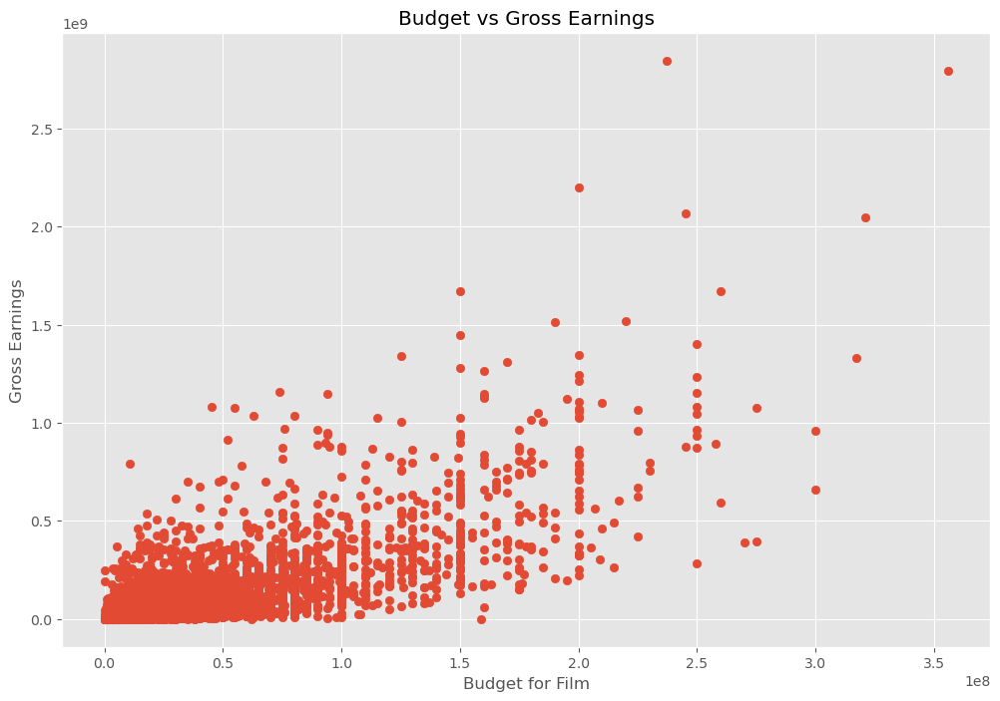

In [262]:
#Scatter plot with budget vs gross

plt.scatter(x=df['budget'], y=df['gross'])

plt.title('Budget vs Gross Earnings')
plt.xlabel('Budget for Film')
plt.ylabel('Gross Earnings')

plt.show()

In [263]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
5445,Avatar,PG-13,Action,2009,2009-12-18,7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,2009
7445,Avengers: Endgame,PG-13,Action,2019,2019-04-26,8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,2019
3045,Titanic,PG-13,Drama,1997,1997-12-19,7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,2015-12-18,7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,2015
7244,Avengers: Infinity War,PG-13,Action,2018,2018-04-27,8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,2018


<Axes: xlabel='budget', ylabel='gross'>

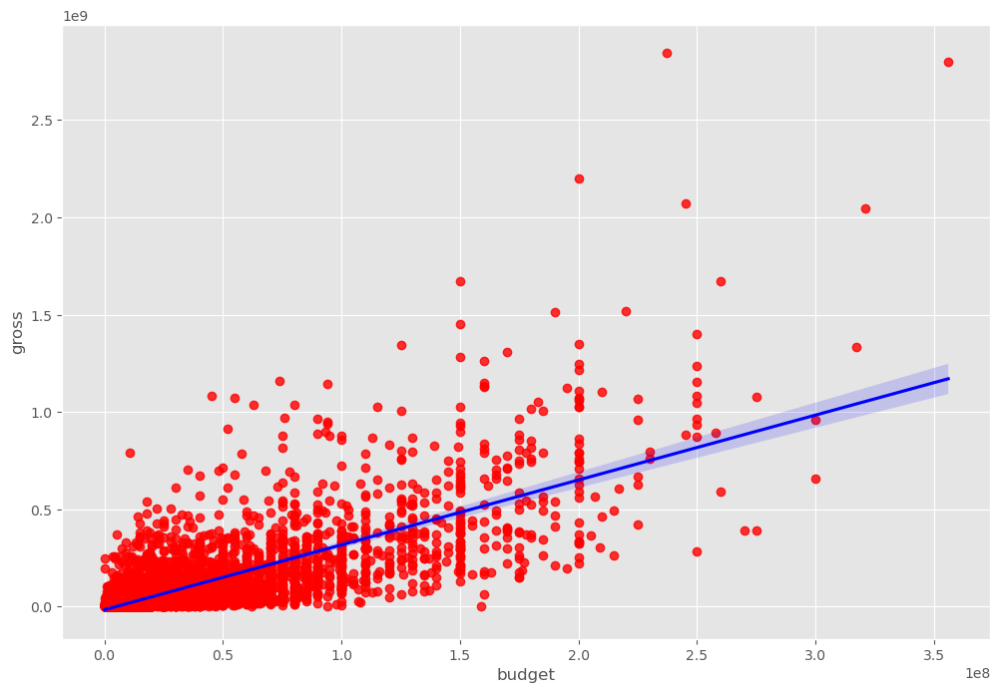

In [264]:
# Plot budget vs gross using seaborn

sns.regplot(x='budget', y='gross', data=df, scatter_kws={'color':'red'}, line_kws={'color':'blue'})

In [265]:
#Let's start looking at correlation

In [266]:
df.corr(numeric_only=True)

,year,score,votes,budget,gross,runtime,Year_correct
year,1.000000,0.055681,0.204904,0.326740,0.273512,0.074849,0.998962
score,0.055681,1.000000,0.474594,0.071552,0.222504,0.414501,0.061443
votes,0.204904,0.474594,1.000000,0.439077,0.614432,0.352263,0.202215
budget,0.326740,0.071552,0.439077,1.000000,0.740028,0.318353,0.319669
gross,0.273512,0.222504,0.614432,0.740028,1.000000,0.275641,0.268141
runtime,0.074849,0.414501,0.352263,0.318353,0.275641,1.000000,0.075183
Year_correct,0.998962,0.061443,0.202215,0.319669,0.268141,0.075183,1.000000


In [267]:
df.corr(numeric_only = True, method='spearman') #3 methods : pearson, kendall, spearman

,year,score,votes,budget,gross,runtime,Year_correct
year,1.000000,0.057269,0.425279,0.311055,0.348700,0.095378,0.998964
score,0.057269,1.000000,0.496104,-0.010972,0.182673,0.412782,0.063547
votes,0.425279,0.496104,1.000000,0.491603,0.744457,0.300912,0.421171
budget,0.311055,-0.010972,0.491603,1.000000,0.691660,0.330007,0.301319
gross,0.348700,0.182673,0.744457,0.691660,1.000000,0.257024,0.338824
runtime,0.095378,0.412782,0.300912,0.330007,0.257024,1.000000,0.095559
Year_correct,0.998964,0.063547,0.421171,0.301319,0.338824,0.095559,1.000000


In [268]:
# High correlation between budget and gross
# I was right

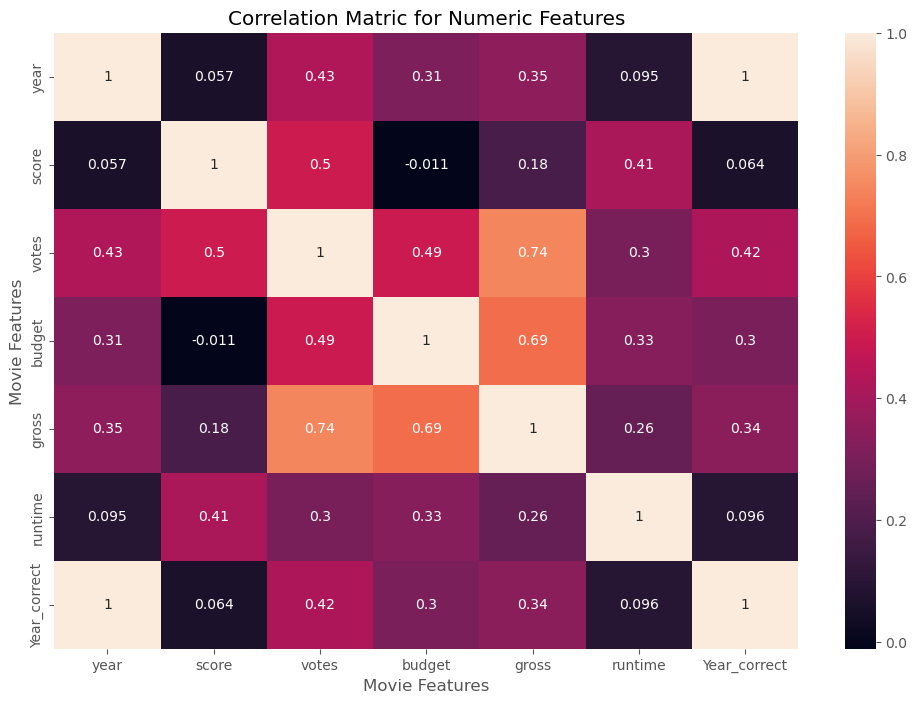

In [269]:
#correlation visualizing
correlation_matrix = df.corr(numeric_only = True, method='spearman')

sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matric for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')


plt.show()

In [278]:
#Looks at Company (not numeric)
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
5445,Avatar,PG-13,Action,2009,2009-12-18,7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,2009
7445,Avengers: Endgame,PG-13,Action,2019,2019-04-26,8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,2019
3045,Titanic,PG-13,Drama,1997,1997-12-19,7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,2015-12-18,7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,2015
7244,Avengers: Infinity War,PG-13,Action,2018,2018-04-27,8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,2018


In [282]:
df_numerized = df.copy()

for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name] = df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
5445,386,5,0,2009,2009-12-18,7.8,1100000,781,1260,1527,47,237000000,2847246203,1376,162,2009
7445,388,5,0,2019,2019-04-26,8.4,903000,105,510,1463,47,356000000,2797501328,978,181,2019
3045,4895,5,6,1997,1997-12-19,7.8,1100000,781,1260,1067,47,200000000,2201647264,1376,194,1997
6663,3632,5,0,2015,2015-12-18,7.8,876000,765,1803,355,47,245000000,2069521700,940,138,2015
7244,389,5,0,2018,2018-04-27,8.4,897000,105,510,1463,47,321000000,2048359754,978,149,2018
7480,4375,4,2,2019,2019-07-19,6.9,222000,1008,1358,454,47,260000000,1670727580,1417,118,2019
6653,2110,5,0,2015,2015-06-12,7.0,593000,334,2519,292,47,150000000,1670516444,1391,124,2015
6043,3866,5,0,2012,2012-05-04,8.0,1300000,1056,1643,1463,47,220000000,1518815515,978,143,2012
6646,1536,5,0,2015,2015-04-03,7.1,370000,805,478,1778,47,190000000,1515341399,1391,137,2015
7494,1525,4,2,2019,2019-11-22,6.8,148000,276,1380,1030,47,150000000,1450026933,1416,103,2019


In [297]:
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
5445,Avatar,PG-13,Action,2009,2009-12-18,7.8,1100000,James Cameron,James Cameron,Sam Worthington,United States,237000000,2847246203,Twentieth Century Fox,162,2009
7445,Avengers: Endgame,PG-13,Action,2019,2019-04-26,8.4,903000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000,2797501328,Marvel Studios,181,2019
3045,Titanic,PG-13,Drama,1997,1997-12-19,7.8,1100000,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000,2201647264,Twentieth Century Fox,194,1997
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,2015-12-18,7.8,876000,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000,2069521700,Lucasfilm,138,2015
7244,Avengers: Infinity War,PG-13,Action,2018,2018-04-27,8.4,897000,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000,2048359754,Marvel Studios,149,2018
7480,The Lion King,PG,Animation,2019,2019-07-19,6.9,222000,Jon Favreau,Jeff Nathanson,Donald Glover,United States,260000000,1670727580,Walt Disney Pictures,118,2019
6653,Jurassic World,PG-13,Action,2015,2015-06-12,7.0,593000,Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,150000000,1670516444,Universal Pictures,124,2015
6043,The Avengers,PG-13,Action,2012,2012-05-04,8.0,1300000,Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,220000000,1518815515,Marvel Studios,143,2012
6646,Furious 7,PG-13,Action,2015,2015-04-03,7.1,370000,James Wan,Chris Morgan,Vin Diesel,United States,190000000,1515341399,Universal Pictures,137,2015
7494,Frozen II,PG,Animation,2019,2019-11-22,6.8,148000,Chris Buck,Jennifer Lee,Kristen Bell,United States,150000000,1450026933,Walt Disney Animation Studios,103,2019


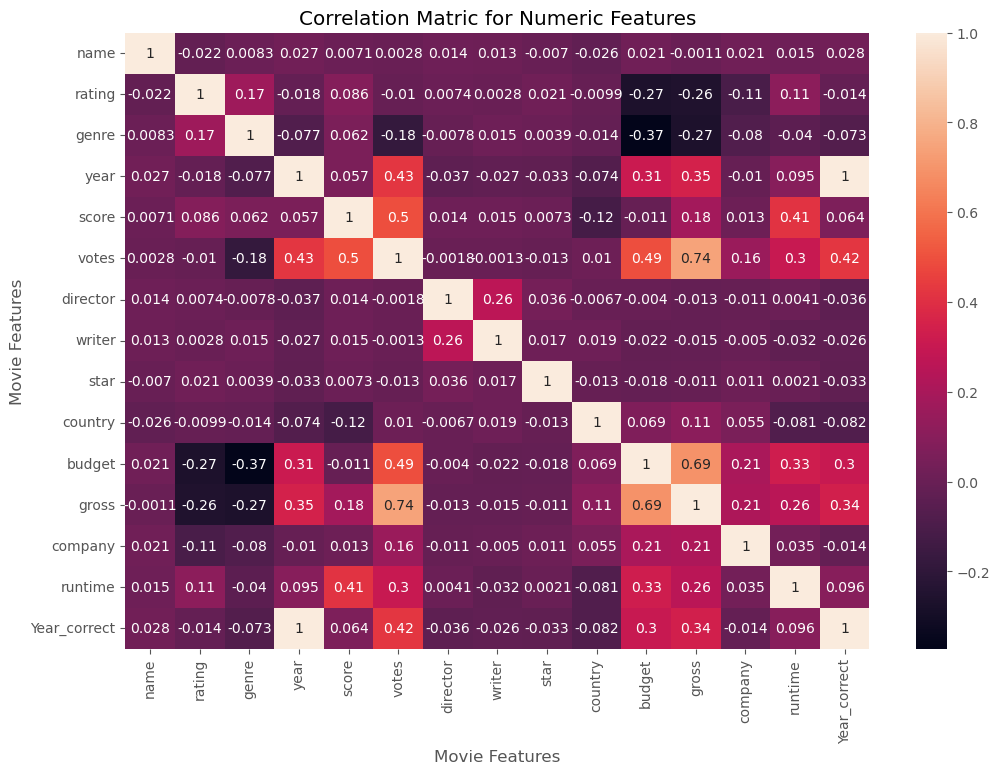

In [299]:
 #correlation visualizing
correlation_matrix = df_numerized.corr(numeric_only = True, method='spearman')

sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matric for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')


plt.show()

In [301]:
df_numerized.corr()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,Year_correct
name,1.000000,-0.029220,0.010840,0.025111,0.026153,0.013644,0.012264,0.014687,0.012449,-0.006846,-0.025192,0.022954,0.005278,0.021215,0.011083,0.025485
rating,-0.029220,1.000000,0.148529,0.019746,0.020905,0.066535,0.006652,0.014283,-0.002375,0.010629,0.009889,-0.203553,-0.181739,-0.092134,0.142450,0.022089
genre,0.010840,0.148529,1.000000,-0.070039,-0.065714,0.035158,-0.134986,-0.009275,0.016506,0.003601,-0.008617,-0.368226,-0.243547,-0.071046,-0.059148,-0.066049
year,0.025111,0.019746,-0.070039,1.000000,0.998900,0.055681,0.204904,-0.037613,-0.024854,-0.032527,-0.067134,0.326740,0.273512,-0.015400,0.074849,0.998962
released,0.026153,0.020905,-0.065714,0.998900,1.000000,0.062860,0.203881,-0.036575,-0.024265,-0.032547,-0.073632,0.321637,0.269843,-0.018979,0.077306,0.999623
score,0.013644,0.066535,0.035158,0.055681,0.062860,1.000000,0.474594,0.006557,0.014493,0.007886,-0.042119,0.071552,0.222504,0.020800,0.414501,0.061443
votes,0.012264,0.006652,-0.134986,0.204904,0.203881,0.474594,1.000000,-0.010430,-0.005376,-0.018099,0.041409,0.439077,0.614432,0.117717,0.352263,0.202215
director,0.014687,0.014283,-0.009275,-0.037613,-0.036575,0.006557,-0.010430,1.000000,0.259625,0.035932,0.011458,-0.009708,-0.029676,-0.009179,0.018158,-0.036274
writer,0.012449,-0.002375,0.016506,-0.024854,-0.024265,0.014493,-0.005376,0.259625,1.000000,0.017183,0.022269,-0.039757,-0.036044,-0.004835,-0.017491,-0.024065
star,-0.006846,0.010629,0.003601,-0.032527,-0.032547,0.007886,-0.018099,0.035932,0.017183,1.000000,-0.011115,-0.022185,-0.000420,0.013621,0.009753,-0.032943


In [305]:
correlation_mat = df_numerized.corr()

corr_pairs = correlation_mat.unstack()

corr_pairs

name          name            1.000000
              rating         -0.029220
              genre           0.010840
              year            0.025111
              released        0.026153
              score           0.013644
              votes           0.012264
              director        0.014687
              writer          0.012449
              star           -0.006846
              country        -0.025192
              budget          0.022954
              gross           0.005278
              company         0.021215
              runtime         0.011083
              Year_correct    0.025485
rating        name           -0.029220
              rating          1.000000
              genre           0.148529
              year            0.019746
              released        0.020905
              score           0.066535
              votes           0.006652
              director        0.014283
              writer         -0.002375
              star       

In [309]:
sorted_pairs = corr_pairs.sort_values()

sorted_pairs

genre         budget         -0.368226
budget        genre          -0.368226
genre         gross          -0.243547
gross         genre          -0.243547
rating        budget         -0.203553
budget        rating         -0.203553
rating        gross          -0.181739
gross         rating         -0.181739
votes         genre          -0.134986
genre         votes          -0.134986
rating        company        -0.092134
company       rating         -0.092134
Year_correct  country        -0.074050
country       Year_correct   -0.074050
              released       -0.073632
released      country        -0.073632
company       genre          -0.071046
genre         company        -0.071046
year          genre          -0.070039
genre         year           -0.070039
year          country        -0.067134
country       year           -0.067134
genre         Year_correct   -0.066049
Year_correct  genre          -0.066049
released      genre          -0.065714
genre         released   

In [321]:
high_corr = sorted_pairs[(sorted_pairs)>0.5]
high_corr

votes         gross           0.614432
gross         votes           0.614432
              budget          0.740028
budget        gross           0.740028
released      year            0.998900
year          released        0.998900
              Year_correct    0.998962
Year_correct  year            0.998962
released      Year_correct    0.999623
Year_correct  released        0.999623
name          name            1.000000
company       company         1.000000
gross         gross           1.000000
budget        budget          1.000000
country       country         1.000000
star          star            1.000000
writer        writer          1.000000
director      director        1.000000
votes         votes           1.000000
score         score           1.000000
released      released        1.000000
year          year            1.000000
genre         genre           1.000000
rating        rating          1.000000
runtime       runtime         1.000000
Year_correct  Year_correc

In [ ]:
#Votes and budget have the highest correlation to gross earnings

#Company has low correlation
#I was wrong